In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
!pip install numpy torch wandb swig gymnasium[box2d] matplotlib termcolor

In [3]:
import test
from utils import *

# Reinforcement Learning Part 1: DQN
By Lawrence Liu and Tonmoy Monsoor
## Some General Instructions

- As before, please keep the names of the layer consistent with what is requested in model.py. Otherwise the test functions will not work

- You will need to fill in the model.py, the DQN.py file, the buffer.py file, and the
env_wrapper.py

DO NOT use Windows for this project, gymnasium does is not supported for windows and installing it will be a pain.

### Introduction to the Enviroment
We will be training a DQN agent to play the game of CarRacing. The agent will be trained to play the game using the pixels of the game as an input. The reward structure is as follows for each frame:
- -0.1 for each frame
- +1000/N where N is the number of tiles visited by the car in the episode

The overall goal of this game is to design a agent that is able to play the game with a average test score of above 600. In discrete mode the actions can take 5 actions,
- 0: Do Nothing
- 1: Turn Left
- 2: Turn Right
- 3: Accelerate
- 4: Brake

First let us visualize the game and understand the environment.

In [4]:
import gymnasium as gym
import numpy as np
env = gym.make('CarRacing-v2', continuous=False, render_mode='rgb_array')
env.np_random = np.random.RandomState(42)

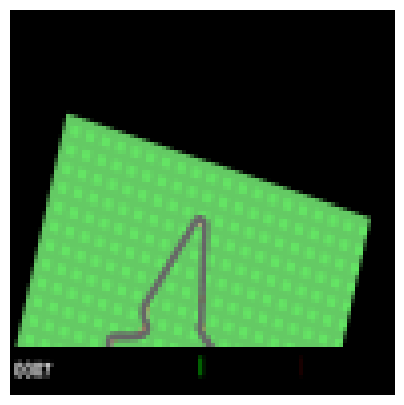

In [5]:

from IPython.display import HTML

frames = []
s, _ = env.reset()

while True:
    a = env.action_space.sample()
    s, r, terminated, truncated, _ = env.step(a)
    frames.append(s)
    if terminated or truncated:
        break


anim = animate(frames)
HTML(anim.to_jshtml())

So a couple things we can note:
- at the beginning of the game, we have 50 frames of the game slowly zooming into the car, we should ignore this period, ie no-op during this period.
- there is a black bar at the bottom of the screen, we should crop this out of the observation. 

In addition, another thing to note is that the current frame doesn't give much information about the velocity and acceleration of the car, and that the car does not move much for each frame.
### Environment Wrapper (5 points)
As a result, you will need to complete `EnvWrapper` in `env_wrapper.py`. You can find more information in the docstring for the wrapper, however the main idea is that it is a wrapper to the environment that does the following:
- skips the first 50 frames of the game
- crops out the black bar and reshapes the observation to a 84x84 image, as well as turning the resulting image to grayscale
- performs the actions for `skip_frames` frames
- stacks the last `num_frames` frames together to give the agent some information about the velocity and acceleration of the car.


In [6]:
from env_wrapper import EnvWrapper

test.test_wrapper(EnvWrapper)

Passed reset
Passed step


### CNN Model (5 points)
Now we are ready to build the model. Our architecture of the CNN model is the one proposed by Mnih et al in "Human-level control through deep reinforcement learning". Specifically this consists of the following layers:
- A convolutional layer with 32 filters of size 8x8 with stride 4 and relu activation
- A convolutional layer with 64 filters of size 4x4 with stride 2 and relu activation
- A convolutional layer with 64 filters of size 3x3 with stride 1 and relu activation
- A fully connected layer with 512 units and relu activation
- A fully connected layer with the number of outputs of the environment

Please implement this model `Nature_Paper_Conv` in `model.py` as well as the helper 
`MLP` class.

In [7]:
import model
test.test_model_DQN(model.Nature_Paper_Conv)

Passed


### DQN (40 points)
Now we are ready to implement the DQN algorithm. 

![title](DQN.png)

#### Replay Buffer (5 points)
First start by implementing the DQN replay buffer `ReplayBufferDQN` in `buffer.py`. This buffer will store the transitions of the agent and sample them for training. 

In [8]:
from replay_buffer import ReplayBufferDQN

test.test_DQN_replay_buffer(ReplayBufferDQN)

Passed



#### DQN (15 points)
Now implement the `_optimize_model` and `sample_action` functions in `DQN` in `DQN.py`. The `_optimize_model` function will sample a batch of transitions from the replay buffer and update the model. The `sample_action` function will sample an action from the model given the current state. Train the model over 200 episodes, validating every 50 episodes for 30 episodes, before testing the model for 50 episodes at the end.

In [32]:
import DQN
import utils
import torch 


trainerDQN = DQN.DQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 700,0.1),
                save_path = utils.get_save_path("DQN","./runs/"))

trainerDQN.train(200,50,30,50,50)
           

saving to ./runs/DQN/run66
Episode: 0: Time: 15.132506847381592 Total Reward: -66.6088328075715 Avg_Loss: 0.7668974514024846
Episode: 1: Time: 16.42733073234558 Total Reward: -28.579335793357963 Avg_Loss: 0.5966392635688686
Episode: 2: Time: 16.658003330230713 Total Reward: 12.011070110701002 Avg_Loss: 0.8020435306047943
Episode: 3: Time: 31.99556565284729 Total Reward: -35.983606557377286 Avg_Loss: 0.9698223541764652
Episode: 4: Time: 19.340357780456543 Total Reward: 7.5641025641022726 Avg_Loss: 1.006918169025864
Episode: 5: Time: 18.3037850856781 Total Reward: -0.1094890510956179 Avg_Loss: 1.1693147734402358
Episode: 6: Time: 17.53414487838745 Total Reward: -58.69636963696435 Avg_Loss: 0.9813393488401124
Episode: 7: Time: 18.12441611289978 Total Reward: 196.2912912912946 Avg_Loss: 1.1929068737858985
Episode: 8: Time: 17.04037880897522 Total Reward: 65.83916083916469 Avg_Loss: 1.606548117364154
Episode: 9: Time: 17.074490070343018 Total Reward: -21.0563380281697 Avg_Loss: 1.7398485243

Please include a plot of the training and validation rewards over the episodes in the report. An additional question to answer is does the loss matter in DQN? Why or why not?

The training reward and validation reward plots are shown below. Yes, the loss does matter in DQN. The loss function is used to measure the difference between predicted Q-values and target Q-values, and we need to minimize this difference in order for the network to adjust the weight values and make better predictions. 

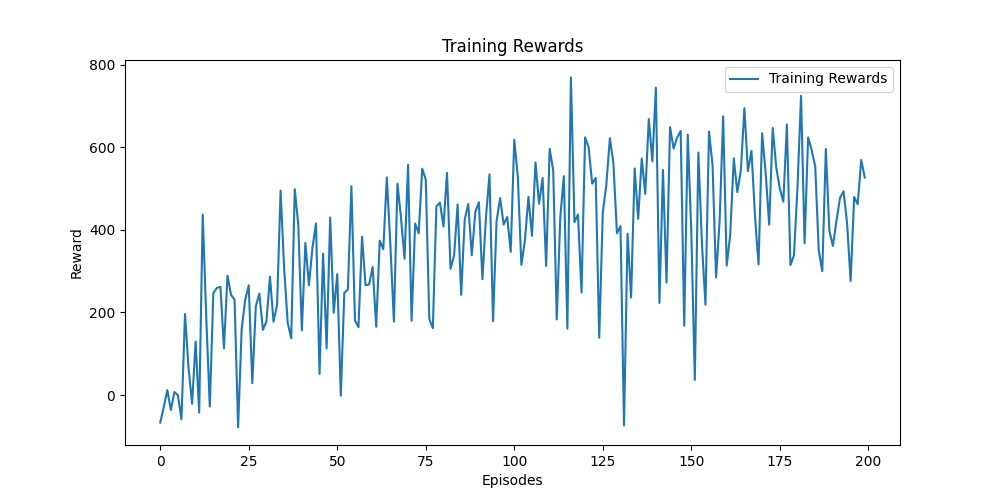

In [33]:
from IPython.display import Image

# Path to the saved figure
training_loss_figure_path = "runs/DQN/run66/training_rewards.png"

# Display the saved figure
display(Image(training_loss_figure_path))

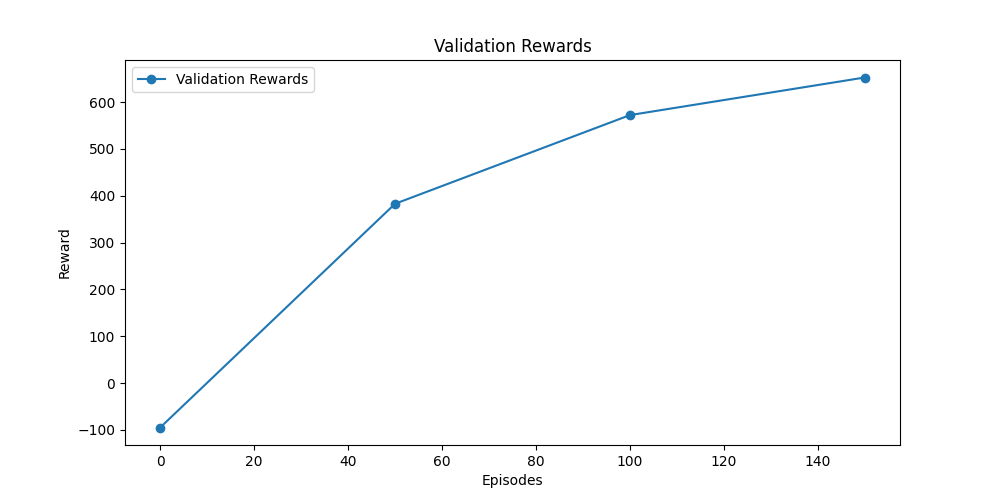

In [34]:
from IPython.display import Image

# Path to the saved figure
training_loss_figure_path = "runs/DQN/run66/validation_rewards.png"

# Display the saved figure
display(Image(training_loss_figure_path))

We can also draw a animation of the car in one game, the code is provided below

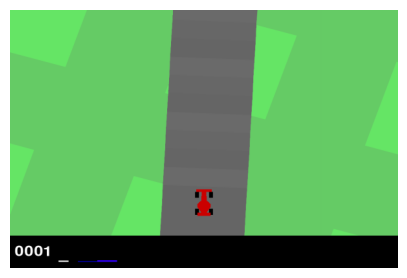

In [35]:
trainerDQN.load_model("best")

eval_env = gym.make('CarRacing-v2', continuous=True, render_mode='rgb_array')
eval_env = EnvWrapper(eval_env)

total_rewards, frames = trainerDQN.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

### Double DQN
In the original paper, where the algorithim is shown above, the estimated target Q value was computed using the current Q network's weights. However, this can lead to overestimation of the Q values. To mitigate this, we can use the target network to compute the target Q value. This is known as Double DQN.
#### Hard updating Target Network (5 points)
Original implementations for this involved hard updates, where the model weights were copied to the target network every C steps. This is known as hard updating. This was what was used in the Nature Paper by Mnih et al 2015 "Human-level control through deep reinforcement learning"

Please implement this by implementing the `_optimize_model` and `_update_model` classes in `HardUpdateDQN` in `DQN.py`.


In [45]:
trainerHardUpdateDQN = DQN.HardUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                update_freq = 100,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_HardUpdates/","./runs/"))

trainerHardUpdateDQN.train(200,50,30,50,50)

saving to ./runs/DoubleDQN_HardUpdates/run29
Episode: 0: Time: 14.513460874557495 Total Reward: -65.69597069597134 Avg_Loss: 0.788901388294239
Episode: 1: Time: 16.283880949020386 Total Reward: -29.210526315789494 Avg_Loss: 0.5680331099747109
Episode: 2: Time: 16.593594312667847 Total Reward: 12.638888888888074 Avg_Loss: 0.7440048483583857
Episode: 3: Time: 16.27495312690735 Total Reward: -62.5090252707588 Avg_Loss: 0.6722823249630067
Episode: 4: Time: 16.277395009994507 Total Reward: -42.36842105263217 Avg_Loss: 0.7067039020109076
Episode: 5: Time: 16.317633152008057 Total Reward: -48.40501792114755 Avg_Loss: 0.6202469496056437
Episode: 6: Time: 16.719456672668457 Total Reward: -59.28571428571477 Avg_Loss: 0.5781430382625896
Episode: 7: Time: 16.733191967010498 Total Reward: -39.63667820069257 Avg_Loss: 0.5470373642263042
Episode: 8: Time: 16.8210391998291 Total Reward: -5.714285714286206 Avg_Loss: 0.5932992365712128
Episode: 9: Time: 16.407400846481323 Total Reward: -27.6599326599333

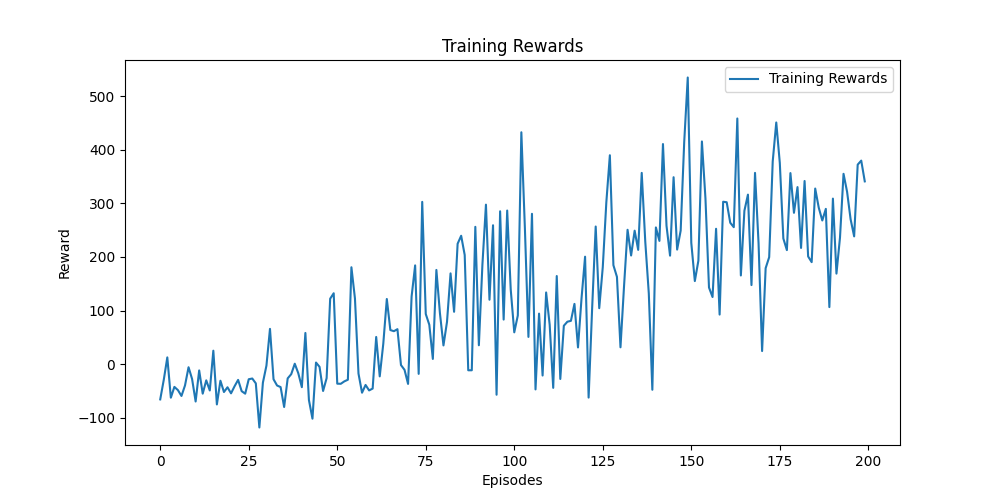

In [46]:
from IPython.display import Image

# Path to the saved figure
training_loss_figure_path = "runs/DoubleDQN_HardUpdates/run29/training_rewards.png"

# Old File = 19

# Display the saved figure
display(Image(training_loss_figure_path))

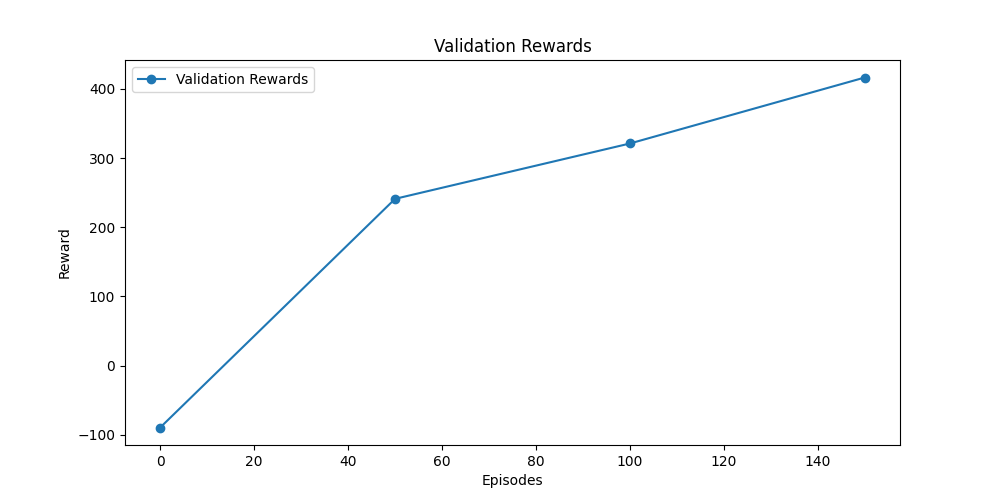

In [47]:
from IPython.display import Image

# Path to the saved figure
training_loss_figure_path = "runs/DoubleDQN_HardUpdates/run29/validation_rewards.png"

# Display the saved figure
display(Image(training_loss_figure_path))

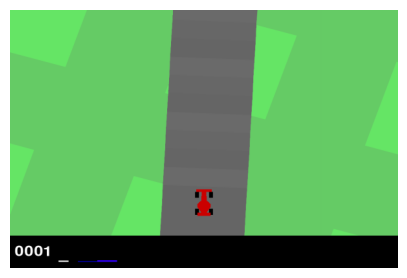

In [48]:
total_rewards, frames = trainerHardUpdateDQN.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

#### Soft Updates (5 points)
A more recent improvement is to use soft updates, also known as Polyak averaging, where the target network is updated with a small fraction of the current model weights every step. In other words:
$$\theta_{target} = \tau \theta_{model} + (1-\tau) \theta_{target}$$
for some $\tau << 1$
Please implement this by implementing the `_update_model` class in `SoftUpdateDQN` in `DQN.py`.

In [49]:
traineSoftUpdateDQN = DQN.SoftUpdateDQN(EnvWrapper(env),
                model.Nature_Paper_Conv,
                tau = 0.01,
                update_freq = 1,
                lr = 0.00025,
                gamma = 0.95,
                buffer_size=100000,
                batch_size=32,
                loss_fn = "mse_loss",
                use_wandb = False,
                device = 'cpu',
                seed = 42,
                epsilon_scheduler = utils.exponential_decay(1, 1000,0.1),
                save_path = utils.get_save_path("DoubleDQN_SoftUpdates","./runs/"))

traineSoftUpdateDQN.train(200,50,30,50,50)

saving to ./runs/DoubleDQN_SoftUpdates/run2
Episode: 0: Time: 14.777553081512451 Total Reward: -29.426229508197366 Avg_Loss: 0.6941525305706809
Episode: 1: Time: 16.245972871780396 Total Reward: -37.76094276094298 Avg_Loss: 0.8447781693221641
Episode: 2: Time: 16.475020170211792 Total Reward: -63.421052631579556 Avg_Loss: 0.6744976853717024
Episode: 3: Time: 16.149070978164673 Total Reward: -60.18987341772224 Avg_Loss: 0.6351788518715555
Episode: 4: Time: 16.19128704071045 Total Reward: -27.203389830508943 Avg_Loss: 0.6399623912391292
Episode: 5: Time: 16.327014207839966 Total Reward: -9.55696202531702 Avg_Loss: 0.5527768432467925
Episode: 6: Time: 16.49984312057495 Total Reward: -26.69398907103878 Avg_Loss: 0.47002858759350136
Episode: 7: Time: 16.51844596862793 Total Reward: -55.96096096096143 Avg_Loss: 0.4686596307574826
Episode: 8: Time: 16.069753170013428 Total Reward: -47.554744525547726 Avg_Loss: 0.5268971989040866
Episode: 9: Time: 16.646394968032837 Total Reward: -49.545454545

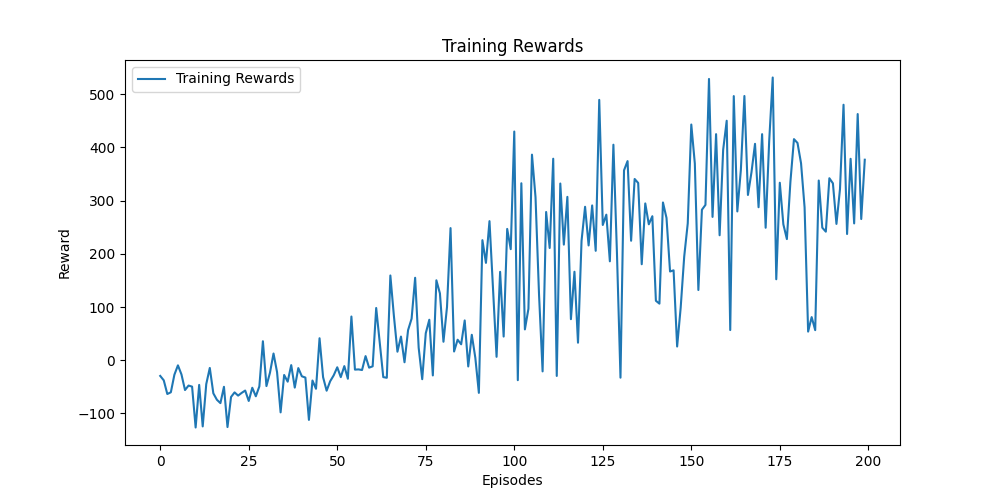

In [50]:
from IPython.display import Image

# Path to the saved figure
training_loss_figure_path = "runs/DoubleDQN_SoftUpdates/run2/training_rewards.png"

# Display the saved figure
display(Image(training_loss_figure_path))

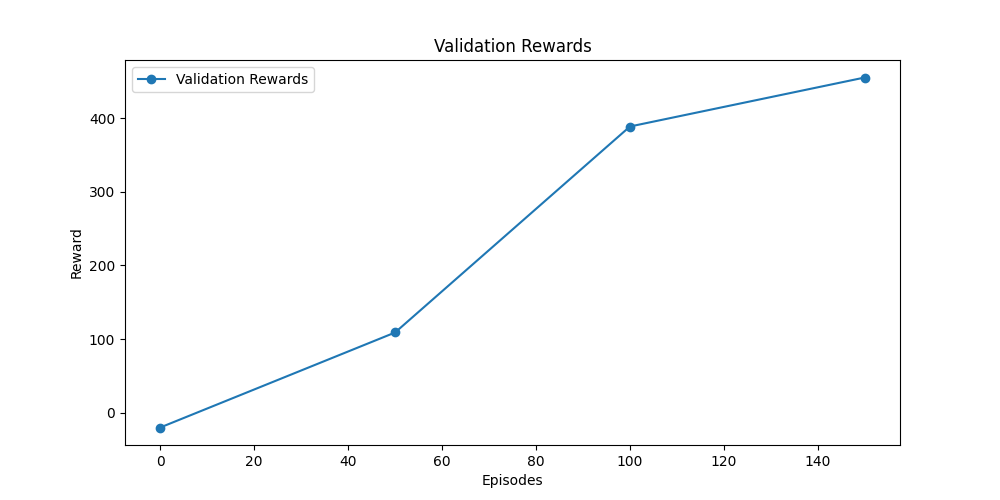

In [51]:
from IPython.display import Image

# Path to the saved figure
training_loss_figure_path = "runs/DoubleDQN_SoftUpdates/run2/validation_rewards.png"

# Display the saved figure
display(Image(training_loss_figure_path))

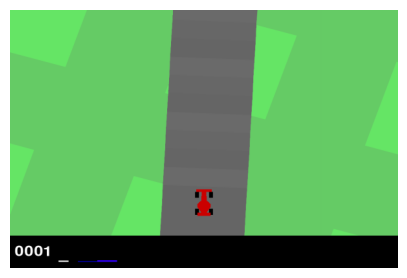

In [52]:
total_rewards, frames = traineSoftUpdateDQN.play_episode(0,True,42)
anim = animate(frames)
HTML(anim.to_jshtml())

#### Questions:
- Which method performed better? (5 points)
    
    In general , soft updating tends to perform better and offers faster learning as it provides a more stable target for the Q-value estimates through continuous adjustments. Based on the results above we achieved the highest validation reward of around 600 with the regular DQN model, followed by the Soft Update DQN model with the highest validation reward of about 450, and lastly, the Hard Update DQN which achieved a maximum validation reward of about 400.

- If we modify the $\tau$ for soft updates or the $C$ for the hard updates, how does this affect the performance of the model, come up with a intuition for this, then experimentally verify this.
 (5 points)

    ##### Hard Update:

- A smaller C means that the target network is updated more frequently, leading to faster learning, but increased instability. This can be seen in the experiments below, as the model with a smaller C of 10, shows more oscillation, but also reaches a higher validation reward of about 450.  

- A larger C leads to more stable learning, but slower learning due to slower adaptation to changes within the main network. From the experiments below, the model with a larger C of 1000 shows slightly less extreme oscillation, but also a slightly lower validation reward of about 400 is achieved in the same number of steps.





    ##### Soft Update:

- A smaller tau means that the target network updates slower, leading to more stable, but slower learning. It would be expected to have a higher average validation reward, with lower variance. From the plots below we can see that a tau of 0.001 gives us more stable training rewards over the steps and also produces the largest validation reward of about 550. 
        
- A larger tau leads to faster updates of the target network, leading to faster learning, but increased instability. It would be expected to have a lower average validation reward with higher variance. From the plots below we can see that a tau of 0.1 gives us much more oscillation in the training reward and also produces a lower validation reward of about 400. 


